Analyze and compare two geospatial datasets
The choice of the datasets is free, but a few constraints must be observed.
	• Use at least 2 different datasets (e.g. model and observations, n different models, 2 different observational datasets, etc.)
	• Perform at least 1 operation in space and 1 operation in time (e.g. aggregation, normalization, resampling, regridding, etc.)
	• Display data both as a function of space and time (time series and maps)
	• Apply some sort of statistical analysis on the data (arrange the data according to some pdf, hypothesis testing, time series analysis, detection of trends, classification, pattern detection, ...)

# Setting librerie

In [1]:
import numpy as np
import xarray as xr
import seaborn as sns
import cmocean
import cartopy.crs as ccrs
from matplotlib import pyplot as plt
import hvplot.xarray
import cartopy.feature as cfeature
import xarray as xr


%matplotlib inline
%config InlinedBackend.figure_format = 'retina'
import warnings
warnings.simplefilter(action='ignore')

# Lettura dataset

In [70]:
# NOAA Optimum Interpolation Sea Surface Temperature V2 (OISSTv2)

# The NOAA OI.v2 SST monthly fields are derived by a linear interpolation of the weekly optimum interpolation (OI) version 2 fields to daily fields then averaging the daily values over a month. The monthly fields are in the same format and spatial resolution as the weekly fields.

# The ice field shows the approximate monthly average of the ice concentration values input to the SST analysis. Ice concentration is stored as the percentage of area covered. For the ice fields, the land and coast grid cells have been set to the netCDF missing value.

In [2]:
# DATASET TEMPERATURE - https://psl.noaa.gov/data/gridded/data.noaa.oisst.v2.html

sst_data = xr.open_dataset('C:/Users/loren/Desktop/sst.mnmean.nc')
sst_data  # sea_surface_temperature (degC) sst

# applico mask
dmask  = xr.open_dataset('C:/Users/loren/Desktop/lsmask.nc')
sst_data['sst'] = sst_data.sst.where(dmask.mask.isel(time=0) == 1)
sst_data

<xarray.Dataset>
Dimensions:    (lat: 180, lon: 360, time: 485, nbnds: 2)
Coordinates:
  * lat        (lat) float32 89.5 88.5 87.5 86.5 ... -86.5 -87.5 -88.5 -89.5
  * lon        (lon) float32 0.5 1.5 2.5 3.5 4.5 ... 356.5 357.5 358.5 359.5
  * time       (time) datetime64[ns] 1981-12-01 1982-01-01 ... 2022-04-01
Dimensions without coordinates: nbnds
Data variables:
    sst        (time, lat, lon) float32 -1.79 -1.79 -1.79 -1.79 ... nan nan nan
    time_bnds  (time, nbnds) datetime64[ns] ...
Attributes:
    title:          NOAA Optimum Interpolation (OI) SST V2
    Conventions:    CF-1.0
    history:        Wed Apr  6 13:47:45 2005: ncks -d time,0,278 SAVEs/sst.mn...
    comments:       Data described in  Reynolds, R.W., N.A. Rayner, T.M.\nSmi...
    platform:       Model
    source:         NCEP Climate Modeling Branch
    institution:    National Centers for Environmental Prediction
    References:     https://www.psl.noaa.gov/data/gridded/data.noaa.oisst.v2....
    dataset_title:  NOAA Optimum Interpolation (OI) SST V2
    source_url:     http://www.emc.ncep.noaa.gov/research/cmb/sst_analysis/

In [3]:
# DATASET GHIACCIAI - https://psl.noaa.gov/data/gridded/data.noaa.oisst.v2.html

icec_data = xr.open_dataset('C:/Users/loren/Desktop/icec.mnmean.nc')
icec_data  # Ice Concentration Mean Surface

<xarray.Dataset>
Dimensions:    (time: 485, lat: 180, lon: 360, nbnds: 2)
Coordinates:
  * lat        (lat) float32 89.5 88.5 87.5 86.5 ... -86.5 -87.5 -88.5 -89.5
  * lon        (lon) float32 0.5 1.5 2.5 3.5 4.5 ... 356.5 357.5 358.5 359.5
  * time       (time) datetime64[ns] 1981-12-01 1982-01-01 ... 2022-04-01
Dimensions without coordinates: nbnds
Data variables:
    icec       (time, lat, lon) float32 ...
    time_bnds  (time, nbnds) datetime64[ns] ...
Attributes:
    title:          NOAA Optimum Interpolation (OI) SST V2
    Conventions:    CF-1.0
    history:        Wed Apr  6 13:51:42 2005: ncks -d time,0,278 SAVEs/icec.m...
    comments:       Data described in  Reynolds, R.W., N.A. Rayner, T.M.\nSmi...
    platform:       Model
    source:         NCEP Climate Modeling Branch
    institution:    National Centers for Environmental Prediction
    References:     https://www.psl.noaa.gov/data/gridded/data.noaa.oisst.v2....
    NCO:            4.0.0
    dataset_title:  NOAA Optimum Interpolation (OI) SST V2
    source_url:     http://www.emc.ncep.noaa.gov/research/cmb/sst_analysis/

# Esplorazione dataset temperatura media superficiale del mare a livello mensile

In [4]:
sst_data.attrs

{'title': 'NOAA Optimum Interpolation (OI) SST V2',
 'Conventions': 'CF-1.0',
 'history': 'Wed Apr  6 13:47:45 2005: ncks -d time,0,278 SAVEs/sst.mnmean.nc sst.mnmean.nc\nCreated 10/2002 by RHS',
 'comments': 'Data described in  Reynolds, R.W., N.A. Rayner, T.M.\nSmith, D.C. Stokes, and W. Wang, 2002: An Improved In Situ and Satellite\nSST Analysis for Climate, J. Climate',
 'platform': 'Model',
 'source': 'NCEP Climate Modeling Branch',
 'institution': 'National Centers for Environmental Prediction',
 'References': 'https://www.psl.noaa.gov/data/gridded/data.noaa.oisst.v2.html',
 'dataset_title': 'NOAA Optimum Interpolation (OI) SST V2',
 'source_url': 'http://www.emc.ncep.noaa.gov/research/cmb/sst_analysis/'}

In [5]:
sst_data.sst.min()  # -1.79
sst_data.sst.max()  # 35.56

<xarray.DataArray 'sst' ()>
array(35.55999756)

Si hanno i dati della temperatura superificiale del mare con granularità mensile.

Viene utilizzato il primo giorno del mese alle ore 00.00.00 per indicare il label del mese.

In particolare si hanno i dati mensili da dicembre 1981 ad aprile 2022, per un totale di 485 istanti temporali.

La griglia è composta da 180 bande di latitudine (ovvero avremo 180 valori di latitudine) e 360 bande di longitudine.
I valori delle variabili di latitudine e longitudine rappresentano i centroidi delle celle che compongono la griglia.

Un elevato numero di osservazioni indicano una temperatura superficiale dell'acqua prossima allo zero.


In [6]:
# distribuzione variabile sst
# sst_data.sst.plot()

sst_data.sst.hvplot()

:NdOverlay   [Element]
   :Histogram   [sst]   (sst_count)

In [19]:
# grafico interattivo per vedere andamento temperatura media globale dal 1981 ogni 8 anni circa

proj = ccrs.PlateCarree()
sst_data.sst.isel(time=slice(0, 485, 100)).hvplot.quadmesh('lon',
                                                         'lat',
                                                         crs = ccrs.PlateCarree(),
                                                         projection=proj,
                                                         project=True,
                                                         global_extent=True,
                                                         rasterize=True,
                                                         color='seawater_temperature',
                                                         cmap=cmocean.cm.thermal,
                                                         dynamic=False,
                                                         coastline=True,
                                                         frame_width=500,
                                                         clim = (-1, 35),
                                                         figsize=(10,13))

:HoloMap   [time]
   :Overlay
      .Image.I     :Image   [lon,lat]   (sst)
      .Coastline.I :Feature   [Longitude,Latitude]

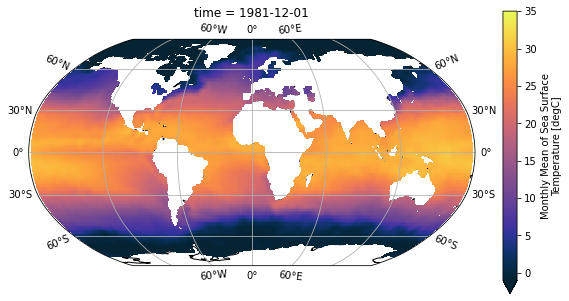

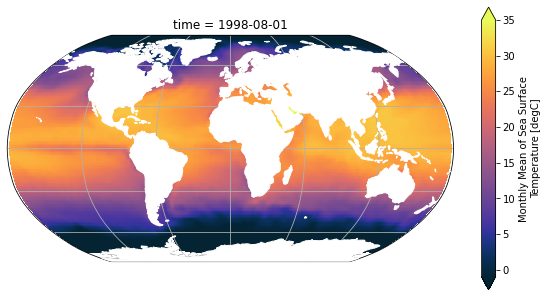

In [20]:
# per un mese specifico

# ad esempio si considera diembre dell'anno 1981
sst = sst_data.sst.sel(time='1981-12-01', method='nearest')
fig = plt.figure(figsize=(10,13))
ax = plt.axes(projection=ccrs.Robinson())
ax.coastlines()
ax.gridlines(draw_labels=True)
sst.plot(ax=ax,
         transform=ccrs.PlateCarree(),
         vmin=-1,
         vmax=35,
         cbar_kwargs={'shrink': 0.4},
         cmap=cmocean.cm.thermal)  # se mettessi il range giusto, -1.79 +35.56 non si vedrebbero bene i vari pattern



# in alternativa (forme dei continenti più definite)
sst = sst_data.sst.sel(time='1981-12-01', method='nearest')
fig = plt.figure(figsize=(10,13))
ax = plt.axes(projection=ccrs.Robinson())
ax.add_feature(cfeature.LAND,zorder=4,color='white')  # al posto di usare il dataset mask
ax.coastlines()
ax.gridlines()
sst.plot(ax=ax,
         transform=ccrs.PlateCarree(),
         vmin=-1,
         vmax=35,
         cbar_kwargs={'shrink': 0.4},
         cmap=cmocean.cm.thermal)

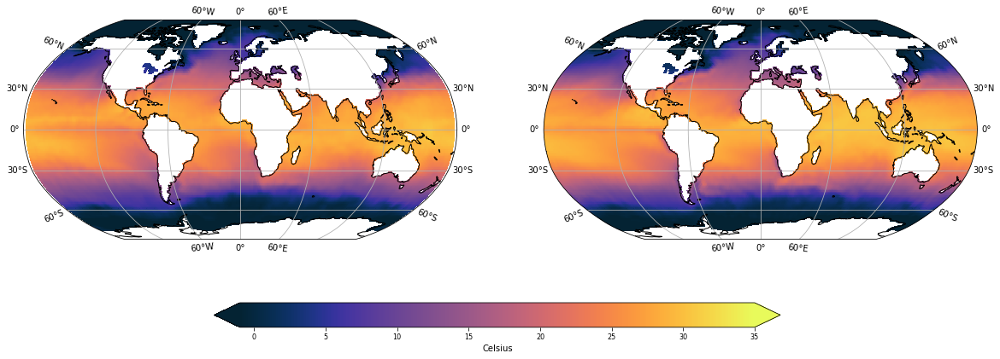

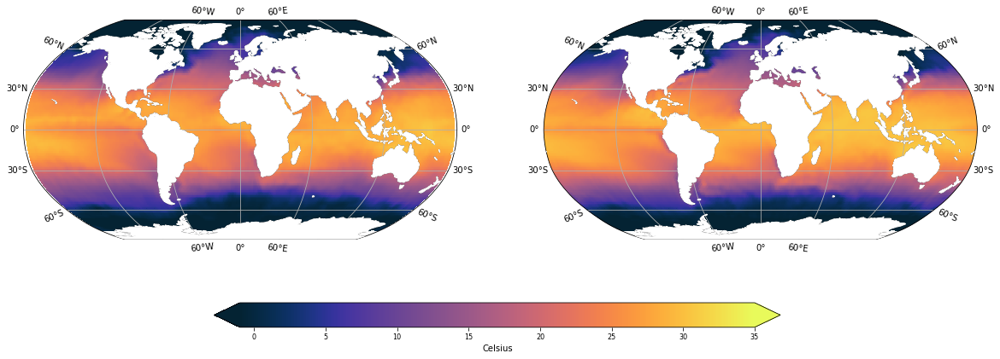

In [23]:
# metto a confronto il primo mese a disposizione con l'ultimo per vedere se sono già visibili graficamente delle differenze

fig = plt.figure(figsize=(20,8))

subplots = (1,2)
n_panels = subplots[0] * subplots[1]

import matplotlib as mpl
# tmax = np.abs(sst_data.sst).max()
# norm = mpl.colors.Normalize(vmin=-tmax,vmax=tmax)  # nel nostro caso hanno già la stessa scala
# cmap = mpl.cm.seismic  # color map con colori rosso e blu, noi usiamo quella di default, si potrebbe optare per una color map specifica


# dicembre 1854
sst = sst_data.sel(time='1981-12-01', method='nearest')  # potei usare altri metodi per selezioanre l'anno
ax = fig.add_subplot(subplots[0], subplots[1], 1, projection=ccrs.Robinson())
# ax.set_title('January 1854')
ax.set_global()
mm = ax.pcolormesh(sst.lon,
                   sst.lat,
                   sst.sst,
                   transform=ccrs.PlateCarree(),
                   vmin=-1,
                   vmax=35,
                   cmap=cmocean.cm.thermal)
ax.coastlines()
ax.gridlines(draw_labels=True)



# aprile 2022
sst = sst_data.sel(time='2022-04-01', method='nearest')
# ax.set_title('January 2022')
ax = fig.add_subplot(subplots[0], subplots[1], 2, projection=ccrs.Robinson())
ax.set_global()
mm = ax.pcolormesh(sst.lon,
                   sst.lat,
                   sst.sst,
                   transform=ccrs.PlateCarree(),
                   vmin=-1,
                   vmax=35,
                   cmap=cmocean.cm.thermal)
ax.coastlines()
ax.gridlines(draw_labels=True)


cbar_ax = fig.add_axes([0.28, 0.10, 0.46, 0.05])
cbar = fig.colorbar(mm, cax=cbar_ax, extend='both', orientation='horizontal')
cbar.set_label('Celsius')
cbar.ax.tick_params(labelsize=8)
plt.show()
plt.close()








# in alternativa
fig = plt.figure(figsize=(20,8))

subplots = (1,2)
n_panels = subplots[0] * subplots[1]

import matplotlib as mpl
# tmax = np.abs(sst_data.sst).max()
# norm = mpl.colors.Normalize(vmin=-tmax,vmax=tmax)  # nel nostro caso hanno già la stessa scala
# cmap = mpl.cm.seismic  # color map con colori rosso e blu, noi usiamo quella di default, si potrebbe optare per una color map specifica


# dicembre 1854
sst = sst_data.sel(time='1981-12-01', method='nearest')  # potei usare altri metodi per selezioanre l'anno
ax = fig.add_subplot(subplots[0], subplots[1], 1, projection=ccrs.Robinson())
ax.add_feature(cfeature.LAND,zorder=4,color='white')  # al posto di usare il dataset mask

# ax.set_title('January 1854')
ax.set_global()
mm = ax.pcolormesh(sst.lon,
                   sst.lat,
                   sst.sst,
                   transform=ccrs.PlateCarree(),
                   vmin=-1,
                   vmax=35,
                   cmap=cmocean.cm.thermal)
ax.coastlines()
ax.gridlines(draw_labels=True)



# aprile 2022
sst = sst_data.sel(time='2022-04-01', method='nearest')
# ax.set_title('January 2022')
ax = fig.add_subplot(subplots[0], subplots[1], 2, projection=ccrs.Robinson())
ax.add_feature(cfeature.LAND,zorder=4,color='white')  # al posto di usare il dataset mask

ax.set_global()
mm = ax.pcolormesh(sst.lon,
                   sst.lat,
                   sst.sst,
                   transform=ccrs.PlateCarree(),
                   vmin=-1,
                   vmax=35,
                   cmap=cmocean.cm.thermal)
ax.coastlines()
ax.gridlines(draw_labels=True)


cbar_ax = fig.add_axes([0.28, 0.10, 0.46, 0.05])
cbar = fig.colorbar(mm, cax=cbar_ax, extend='both', orientation='horizontal')
cbar.set_label('Celsius')
cbar.ax.tick_params(labelsize=8)


plt.show()
plt.close()


# oosservando i deue grafico la differenza non è netta, si potrebbe dire che nei pressi dell'equatore si vede un incremento con il passare degli anni

In [30]:
sst_data

<xarray.Dataset>
Dimensions:    (lat: 180, lon: 360, time: 485, nbnds: 2)
Coordinates:
  * lat        (lat) float32 89.5 88.5 87.5 86.5 ... -86.5 -87.5 -88.5 -89.5
  * lon        (lon) float32 0.5 1.5 2.5 3.5 4.5 ... 356.5 357.5 358.5 359.5
  * time       (time) datetime64[ns] 1981-12-01 1982-01-01 ... 2022-04-01
Dimensions without coordinates: nbnds
Data variables:
    sst        (time, lat, lon) float32 -1.79 -1.79 -1.79 -1.79 ... nan nan nan
    time_bnds  (time, nbnds) datetime64[ns] 1981-12-01 1982-01-01 ... 2022-05-01
Attributes:
    title:          NOAA Optimum Interpolation (OI) SST V2
    Conventions:    CF-1.0
    history:        Wed Apr  6 13:47:45 2005: ncks -d time,0,278 SAVEs/sst.mn...
    comments:       Data described in  Reynolds, R.W., N.A. Rayner, T.M.\nSmi...
    platform:       Model
    source:         NCEP Climate Modeling Branch
    institution:    National Centers for Environmental Prediction
    References:     https://www.psl.noaa.gov/data/gridded/data.noaa.oisst.v2....
    dataset_title:  NOAA Optimum Interpolation (OI) SST V2
    source_url:     http://www.emc.ncep.noaa.gov/research/cmb/sst_analysis/

In [39]:
# temperature medie per ciascun mese

sst = sst_data.sst.groupby('time.month').mean('time')  # medie di tutti i mesi per tutti gli anni
# sst[0,:,:]   seleziono il solo mese di gennaio (media di tutti i gennai nel dataset di tutti gli anni)

# for i in range(12):
#     fig = plt.figure(figsize=(10,13))
#     ax = plt.axes(projection=ccrs.Robinson())
#     ax.coastlines()
#     ax.gridlines()
#     sst[i,:,:].plot(ax=ax, transform=ccrs.PlateCarree(),
#              vmin=-1, vmax=30, cbar_kwargs={'shrink': 0.4}, cmap=cmocean.cm.thermal)  # oppure non metto nulla come cmap


# grafico interattivo
proj = ccrs.PlateCarree()
sst.isel(month=slice(0, 12, 1)).hvplot.quadmesh('lon',
                                                         'lat',
                                                         crs = ccrs.PlateCarree(),
                                                         projection=proj,
                                                         project=True,
                                                         global_extent=True,
                                                         rasterize=True,
                                                         color='seawater_temperature',
                                                         cmap=cmocean.cm.thermal,
                                                         dynamic=False,
                                                         coastline=True,
                                                         frame_width=500,
                                                         clim = (-1, 35),
                                                         figsize=(10,13))

:HoloMap   [month]
   :Overlay
      .Image.I     :Image   [lon,lat]   (sst)
      .Coastline.I :Feature   [Longitude,Latitude]

In [44]:
# media dei mesi negli anni

fig = plt.figure(figsize=(20,8))

subplots = (6,2)
n_panels = subplots[0] * subplots[1]


plt.show()
plt.close()

<Figure size 1440x576 with 0 Axes>

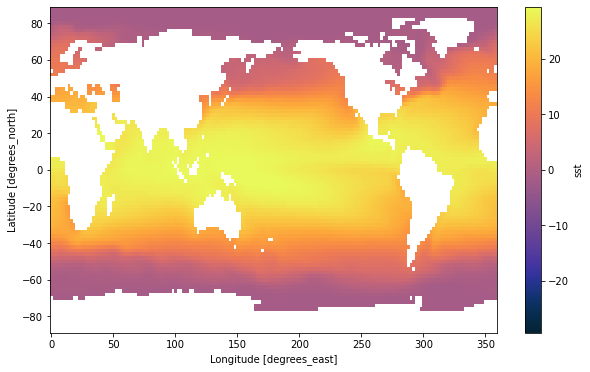

In [15]:
# si comprime la dimensione del tempo calcolando la media
# viene riportata la media della variabile sst lungo la linea del tempo
fig = plt.figure(figsize=(10,6))
sst_data.sst.mean(axis=0).plot(cmap=cmocean.cm.thermal)

In [58]:
sst_data

<xarray.Dataset>
Dimensions:    (lat: 180, lon: 360, time: 485, nbnds: 2)
Coordinates:
  * lat        (lat) float32 89.5 88.5 87.5 86.5 ... -86.5 -87.5 -88.5 -89.5
  * lon        (lon) float32 0.5 1.5 2.5 3.5 4.5 ... 356.5 357.5 358.5 359.5
  * time       (time) datetime64[ns] 1981-12-01 1982-01-01 ... 2022-04-01
Dimensions without coordinates: nbnds
Data variables:
    sst        (time, lat, lon) float32 -1.79 -1.79 -1.79 -1.79 ... nan nan nan
    time_bnds  (time, nbnds) datetime64[ns] 1981-12-01 1982-01-01 ... 2022-05-01
Attributes:
    title:          NOAA Optimum Interpolation (OI) SST V2
    Conventions:    CF-1.0
    history:        Wed Apr  6 13:47:45 2005: ncks -d time,0,278 SAVEs/sst.mn...
    comments:       Data described in  Reynolds, R.W., N.A. Rayner, T.M.\nSmi...
    platform:       Model
    source:         NCEP Climate Modeling Branch
    institution:    National Centers for Environmental Prediction
    References:     https://www.psl.noaa.gov/data/gridded/data.noaa.oisst.v2....
    dataset_title:  NOAA Optimum Interpolation (OI) SST V2
    source_url:     http://www.emc.ncep.noaa.gov/research/cmb/sst_analysis/


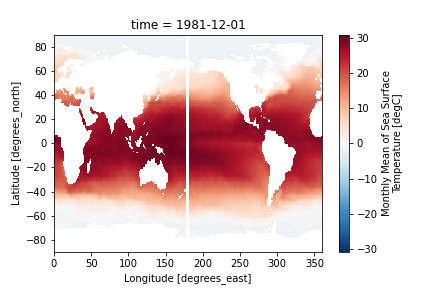

In [64]:
# sst_data.sst.hvplot.quadmesh(x='lon',
#                              y='lat',
#                              geo=True,
#                              widget_location='bottom',
#                              rasterize=True, project=True)

import panel.widgets as pnw

sst_data.sst.interactive.sel(time=pnw.DiscreteSlider).plot()


In [63]:
# set constant colorbar limits
icec_data.icec.hvplot(
    groupby="time",  # adds a widget for time
    #clim=(250, 295),  # sets colormap limits
    widget_type="scrubber",
    widget_location="bottom",
)



Column
    [0] HoloViews(DynamicMap, widget_location='bottom', widget_type='scrubber')
    [1] Row
        [0] HSpacer()
        [1] WidgetBox
            [0] Player(end=484, width=550)
        [2] HSpacer()

Da questi plot si può dunque notare che le temperature più basse si verificano nei pressi dei poli mentre avvicinandosi all'equatore le temperature aumentano in modo graduale. Inoltre ad una prima vista ad alto livello non si notano differenze nette nel corso degli anni, vedi 1854 vs 2022.

In [16]:
# serie temporale mensile globale

# quando faccio queste medei valutare se devo fare medie pesate

# è una grande media, quindi un'aggregazione spaziale a differenza di fare l'interpolazione

sst_data.mean(("lon", "lat"), keep_attrs=True).sst.hvplot()  # a livello mensile

:Curve   [time]   (sst)

In [17]:
# serie temporale mensile per una cella specifica

sst_data.lat[1]  # 86, siamo nella zona del polo nord
sst_data.lon[80]  # 160
# queste coordinate si vedono in alto al grafico se si usa il comando plot

sst_data.sst.groupby("time.month").mean("time")[:,1,80].hvplot()  # dunque questa è la temeratura media a livello mensile per la cella 86:160

:Curve   [month]   (sst)

In [18]:
# proviamo ora con la temperatura di una cella vicino all'equatore

sst_data.lat[40]  # 8, siamo vicini all'equatore, infatti qui si notano temperature molto più elevate
sst_data.lon[80]  # 160
# queste coordinate si vedono in alto al grafico

sst_data.sst.groupby("time.month").mean("time")[:,40,80].hvplot()

:Curve   [month]   (sst)

In [19]:
# vediamo cosa succede nell'emisfero australe, le stagioni dovrebbero essere invertite

sst_data.lat[60]  # -32, siamo nell'emisfero australe, come previsto i primi mesi dell'anno sono i più caldi e ad agsoto si ha il mese più freddo
sst_data.lon[80]  # 160
# queste coordinate si vedono in alto al grafico

sst_data.sst.groupby("time.month").mean("time")[:,60,80].hvplot()

:Curve   [month]   (sst)

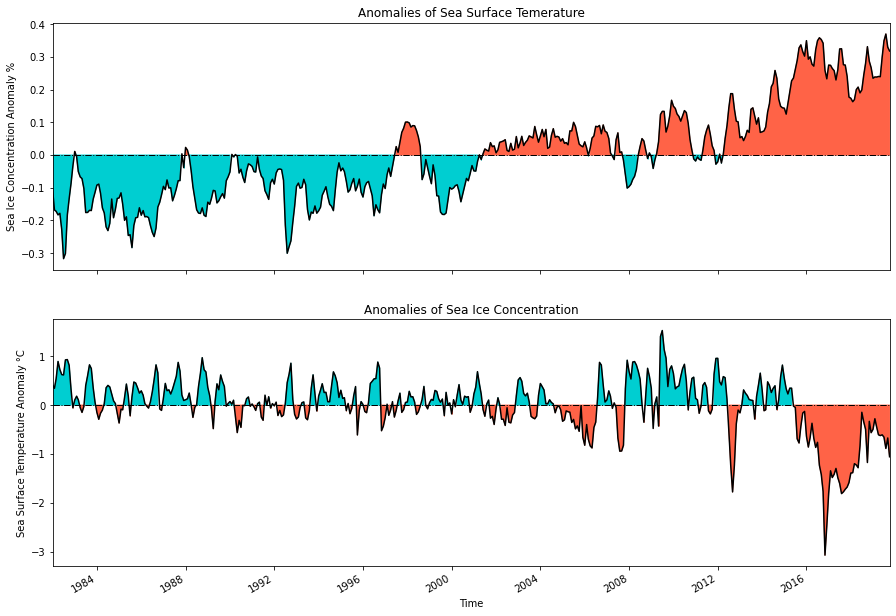

In [20]:
# calcolo delle anomalie


# calcolo prima normali

# cambio bene i nomi delle variabili
fig,ax = plt.subplots(figsize=(15,10), nrows=2)

sst = sst_data.sel(time=slice('1982-01-01','2019-10-01'))
gb_sst = sst.groupby('time.month')
sst_anom = gb_sst - gb_sst.mean(dim='time')
sst_mean = sst_anom.sst.mean(dim=('lat','lon'))
sst_mean.plot(ax=ax[0], c='black')
ax[0].axhline(y=0, c='black', linewidth=1, linestyle='dashdot')
ax[0].set_title('Anomalies of Sea Surface Temerature')
ax[0].set_ylabel('Sea Ice Concentration Anomaly %')
ax[0].label_outer()
date_sst = sst_mean.time.values
ax[0].set_xlim(date_sst[0], date_sst[-1])
ax[0].fill_between(date_sst, sst_mean.where(sst_mean>0), 0, color='tomato')
ax[0].fill_between(date_sst, sst_mean.where(sst_mean<0), 0, color='darkturquoise')

icec = icec_data.sel(time=slice('1982-01-01','2019-10-01'))
gb_icec = icec.groupby('time.month')
icec_anom = gb_icec - gb_icec.mean(dim='time')
icec_mean = icec_anom.icec.mean(dim=('lat','lon'))
icec_mean.plot(ax=ax[1], c='black')
ax[1].axhline(y=0, c='black', linewidth=1, linestyle='dashdot')
ax[1].set_title('Anomalies of Sea Ice Concentration')
ax[1].set_ylabel('Sea Surface Temperature Anomaly °C')
date_icec = icec_mean.time.values
ax[1].set_xlim(date_icec[0], date_icec[-1])
ax[1].fill_between(date_icec, icec_mean.where(icec_mean<0), 0, color='tomato')
ax[1].fill_between(date_icec, icec_mean.where(icec_mean>0), 0, color='darkturquoise')

# Based on the line plots above, we can indentify that the anomalies of sea surface temperature and sea ice concentration are roughly matched. From 1982 to 2019, sea surface temperature was increasing, while sea ice concentration was decreasing.

# Esplorazione dataset concentrazione di ghiaccio a livello mensile

The parameter of this data set is sea ice concentration which is the fraction of ocean area covered
by sea ice. Sea ice concentration represents an areal coverage of sea ice. For a given grid cell, the
parameter provides an estimate of the fractional amount of sea ice covering that cell, with the
remainder of the area consisting of open ocean. Land areas are coded with a land mask value.

The ice field shows the approximate monthly average of the ice concentration values input to the SST analysis. Ice concentration is stored as the percentage of area covered. For the ice fields, the land and coast grid cells have been set to the netCDF missing value.

In [21]:
icec_data.attrs

{'title': 'NOAA Optimum Interpolation (OI) SST V2',
 'Conventions': 'CF-1.0',
 'history': 'Wed Apr  6 13:51:42 2005: ncks -d time,0,278 SAVEs/icec.mnmean.nc icec.mnmean.nc\nCreated 10/2002 by RHS\nN.B. The land values in this ice concentration data set have been set to the missing value of 32767.  The land values vary with time.',
 'comments': 'Data described in  Reynolds, R.W., N.A. Rayner, T.M.\nSmith, D.C. Stokes, and W. Wang, 2002: An Improved In Situ and Satellite\nSST Analysis for Climate, J. Climate',
 'platform': 'Model',
 'source': 'NCEP Climate Modeling Branch',
 'institution': 'National Centers for Environmental Prediction',
 'References': 'https://www.psl.noaa.gov/data/gridded/data.noaa.oisst.v2.html',
 'NCO': '4.0.0',
 'dataset_title': 'NOAA Optimum Interpolation (OI) SST V2',
 'source_url': 'http://www.emc.ncep.noaa.gov/research/cmb/sst_analysis/'}

In [22]:
icec_data.icec.min()  # 0
icec_data.icec.max()  # 100

# sono già valori in percentuale
# attenzione perchè 0 è diverso da nan, 0 indica che non c'è ghiaccio mentre nan indica che è terra ferma

<xarray.DataArray 'icec' ()>
array(100.00999451)

In [23]:
# distribuzione variabile icec
# icec_data.icec.plot()

icec_data.icec.hvplot()

:NdOverlay   [Element]
   :Histogram   [icec]   (icec_count)

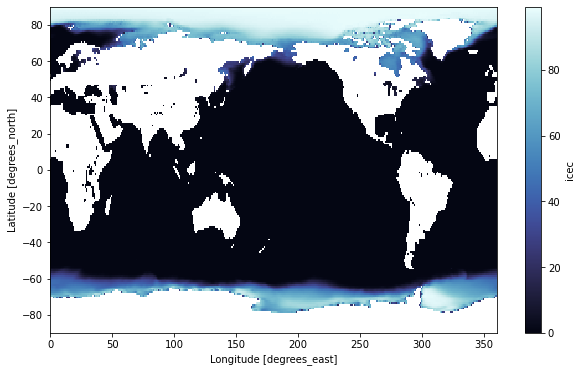

In [24]:
fig = plt.figure(figsize=(10,6))
icec_data.icec.mean(axis=0).plot(cmap=cmocean.cm.ice)

Si hanno i dati della concentrazione di ghiaccio con granularità mensile. Vi sono valori null in corrispondenza della terra ferma.

Viene utilizzato il primo giorno del mese alle ore 00.00.00 per indicare il label del mese.

In particolare si hanno i dati mensili da dicembre 1981 a marzo 2022, per un totale di 484 istanti temporali.

La griglia è composta da 180 bande di latitudine e 360 bande di longitudine.

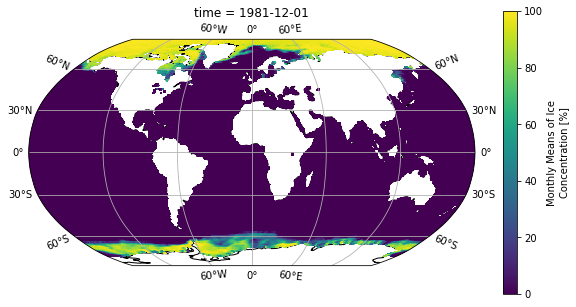

In [25]:
# per un mese specifico, gennaio dell'anno 1854
sst = icec_data.icec.sel(time='1981-12-01', method='nearest')
fig = plt.figure(figsize=(10,13))
ax = plt.axes(projection=ccrs.Robinson())  # projection indica il ccrs che vogliamo avere come visualizzazione
ax.coastlines()
ax.gridlines(draw_labels=True)
sst.plot(ax=ax, transform=ccrs.PlateCarree(),  # transform indica il ccrs dei nostri dati di partenza
         vmin=0, vmax=100, cbar_kwargs={'shrink': 0.4})

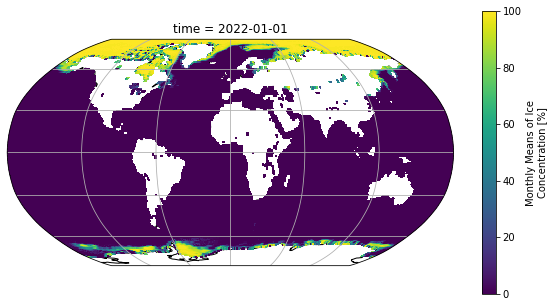

In [26]:
# per un mese specifico, gennaio dell'anno 2022
sst = icec_data.icec.sel(time='2022-01-01', method='nearest')
fig = plt.figure(figsize=(10,13))
ax = plt.axes(projection=ccrs.Robinson())
ax.coastlines()
ax.gridlines()
sst.plot(ax=ax, transform=ccrs.PlateCarree(),
         vmin=0, vmax=100, cbar_kwargs={'shrink': 0.4})

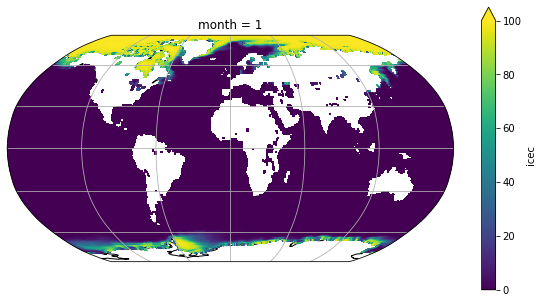

In [27]:
# gennaio medio

sst = icec_data.icec.groupby('time.month').mean('time')  # medie di tutti i mesi per tutti gli anni
sst[0,:,:]  # seleziono il solo mese di gennaio (media di tutti i gennai nel dataset di tutti gli anni)

sst = sst[0,:,:]
fig = plt.figure(figsize=(10,13))
ax = plt.axes(projection=ccrs.Robinson())
ax.coastlines()
ax.gridlines()
sst.plot(ax=ax, transform=ccrs.PlateCarree(),
         vmin=0, vmax=100, cbar_kwargs={'shrink': 0.4})

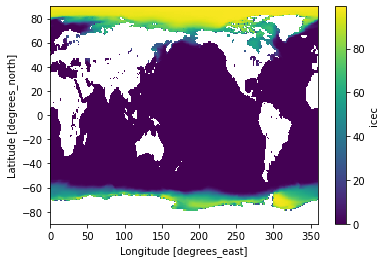

In [28]:
# si comprime la dimensione del tempo calcolando la media
# viene riportata la media della variabile icec lungo la linea del tempo
icec_data.icec.mean(axis=0).plot()

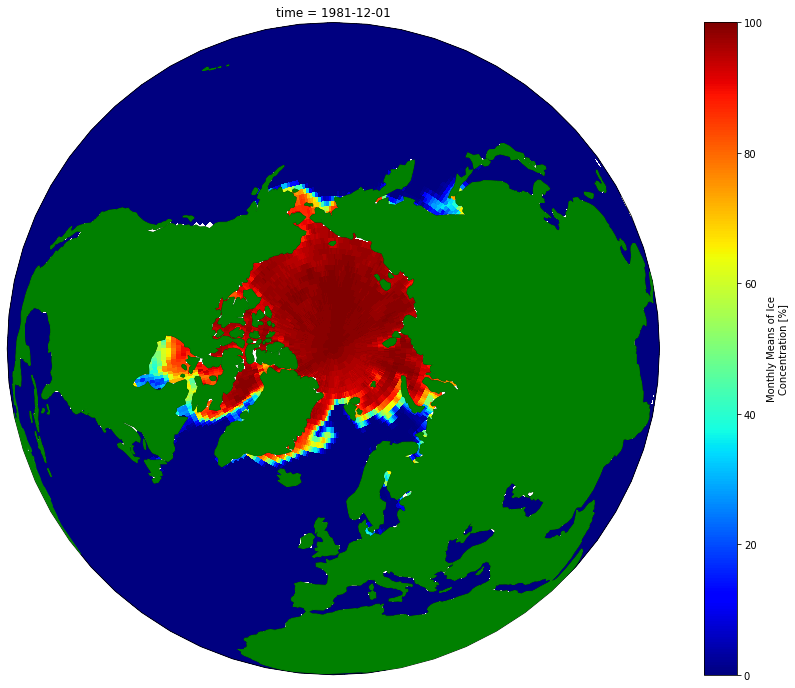

In [59]:
# North Pole - anno 1981

fig = plt.figure(figsize=(16,12))
ax = plt.axes(projection=ccrs.Orthographic(central_longitude=0.0, central_latitude=90))  # uso questa struttura di codice anche per altre celle
# ax = plt.axes(projection=ccrs.LambertConformal(central_longitude=0.0, central_latitude=90))
p1a = icec_data.icec.isel(time=0).plot(transform=ccrs.PlateCarree(),
                                                       vmin=0,
                                                       vmax=100,
                                                       #subplot_kws={'projection': ccrs.Orthographic(central_longitude=0.0, central_latitude=90)},
                                                       cmap='jet')
import cartopy.feature as cfeature
ax.add_feature(cfeature.LAND,zorder=4,color='green')

p1a.axes.coastlines()

# dovrebbe essere polo nord , vedi https://www.google.com/search?q=polo+nord&sxsrf=ALiCzsZ_eygOUHgqEHG7fIBQ6lSXpTzLwg:1651851809597&source=lnms&tbm=isch&sa=X&ved=2ahUKEwick9TCm8v3AhUmRfEDHY2qDW0Q_AUoAnoECAIQBA&biw=1440&bih=757&dpr=1#imgrc=txk_DHzN_-gKMM

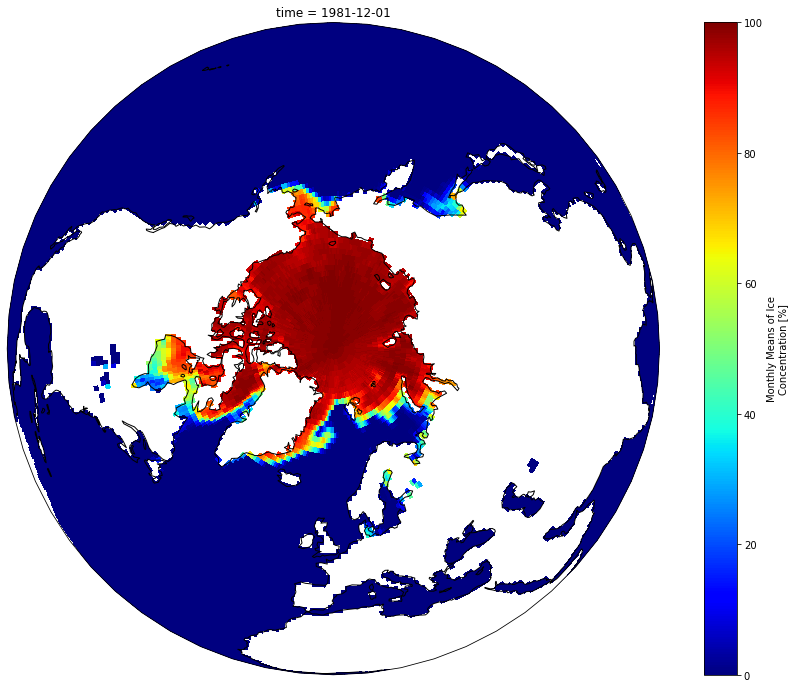

In [46]:
# North Pole - anno 1981
import cartopy.feature as cfeature

fig = plt.figure(figsize=(16,12))
ax = plt.axes(projection=ccrs.Orthographic(central_longitude=0.0, central_latitude=90))  # uso questa struttura di codice anche per altre celle
# ax = plt.axes(projection=ccrs.LambertConformal(central_longitude=0.0, central_latitude=90))
p1a = icec_data.icec.isel(time=0).plot(transform=ccrs.PlateCarree(),
                                                       vmin=0,
                                                       vmax=100,
                                                       #subplot_kws={'projection': ccrs.Orthographic(central_longitude=0.0, central_latitude=90)},
                                                       cmap='jet')

p1a.axes.coastlines()

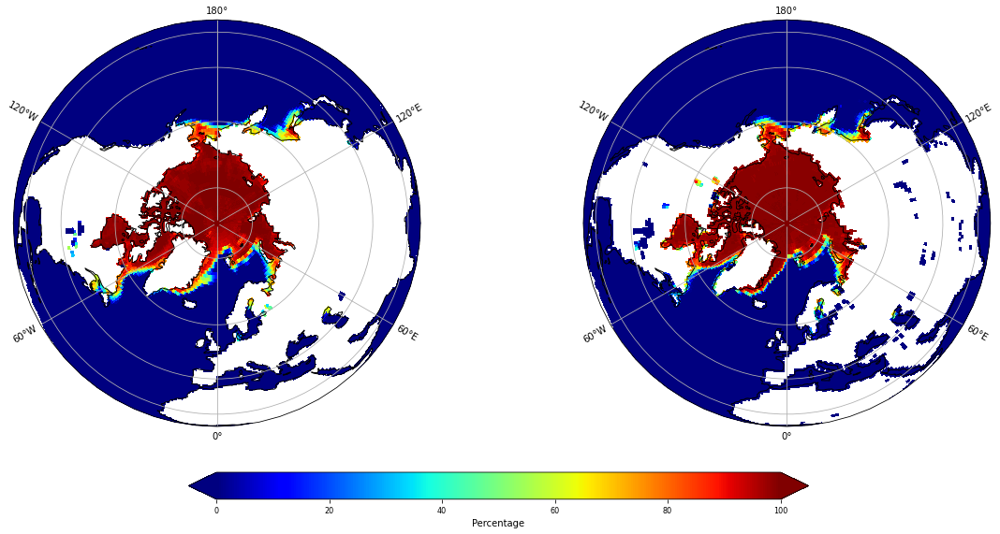

In [30]:
fig = plt.figure(figsize=(20,8))

subplots = (1,2)
n_panels = subplots[0] * subplots[1]


# gennaio 1854
sst = icec_data.sel(time='1990-01-01', method='nearest')  # potei usare altri metodi per selezioanre l'anno
ax = fig.add_subplot(subplots[0], subplots[1], 1, projection=ccrs.Orthographic(central_longitude=0.0, central_latitude=90))
# ax.set_title('January 1854')
ax.set_global()
mm = ax.pcolormesh(sst.lon, sst.lat, sst.icec,
                   transform=ccrs.PlateCarree(), cmap='jet'
)
ax.coastlines()
ax.gridlines(draw_labels=True)




sst = icec_data.sel(time='2010-01-01', method='nearest')
# ax.set_title('January 2022')
ax = fig.add_subplot(subplots[0], subplots[1], 2, projection=ccrs.Orthographic(central_longitude=0.0, central_latitude=90))
ax.set_global()
mm = ax.pcolormesh(sst.lon, sst.lat, sst.icec,
                   transform=ccrs.PlateCarree(), cmap='jet'
)
ax.coastlines()
ax.gridlines(draw_labels=True)


cbar_ax = fig.add_axes([0.28, -0.01, 0.46, 0.05])
cbar = fig.colorbar(mm, cax=cbar_ax, extend='both', orientation='horizontal', cmap='jet'
)
cbar.set_label('Percentage')
cbar.ax.tick_params(labelsize=8)


plt.show()
plt.close()

A differenza del dataset delle temperature superficiali dell'acqua in questo caso le differenze tra gli anni sono evidenti, vedi 1854 vs 2022

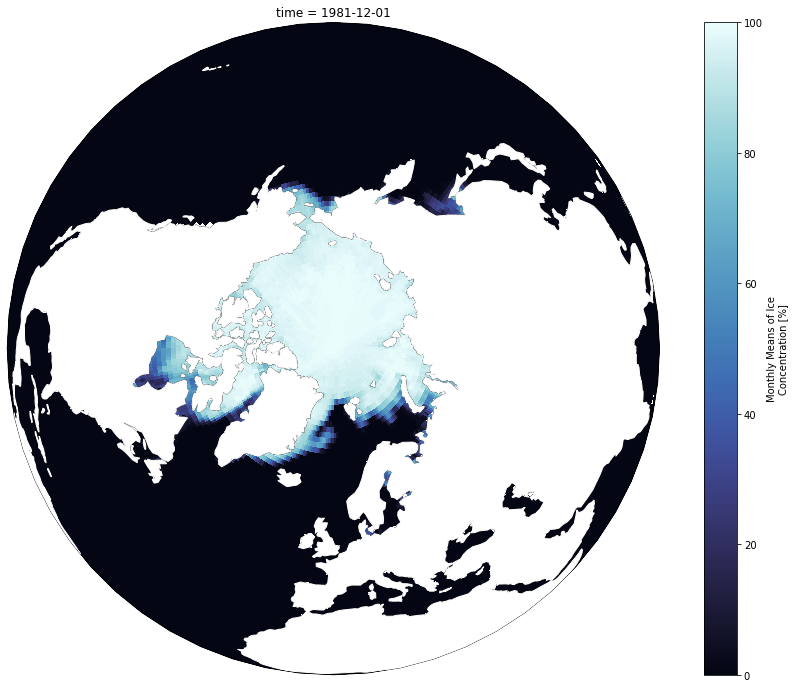

In [75]:
# utilizzando cmpa adatta per ice



# North Pole - anno 1981

import cmocean

fig = plt.figure(figsize=(16,12))
ax = plt.axes(projection=ccrs.Orthographic(central_longitude=0.0, central_latitude=90))

p1a = icec_data.icec.isel(time=0).plot(transform=ccrs.PlateCarree(),
                                                       vmin=0,
                                                       vmax=100,
                                                       cmap=cmocean.cm.ice)

ax.add_feature(cfeature.LAND,zorder=4,color='white')

p1a.axes.coastlines()

# dovrebbe essere polo nord , vedi https://www.google.com/search?q=polo+nord&sxsrf=ALiCzsZ_eygOUHgqEHG7fIBQ6lSXpTzLwg:1651851809597&source=lnms&tbm=isch&sa=X&ved=2ahUKEwick9TCm8v3AhUmRfEDHY2qDW0Q_AUoAnoECAIQBA&biw=1440&bih=757&dpr=1#imgrc=txk_DHzN_-gKMM





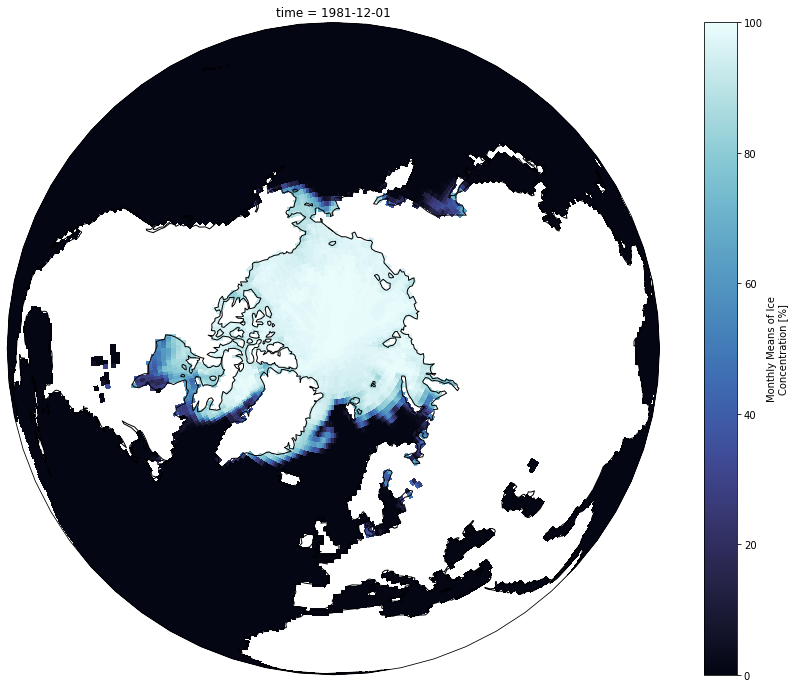

In [63]:
# utilizzando cmpa adatta per ice



# North Pole - anno 1981

import cmocean
fig = plt.figure(figsize=(16,12))
p1a = icec_data.icec.isel(time=0).plot(transform=ccrs.PlateCarree(),
                                                       vmin=0,
                                                       vmax=100,
                                                       subplot_kws={'projection': ccrs.Orthographic(central_longitude=0.0, central_latitude=90)},   # messo +90 per polo nord?? prima era sud e ed era -90
                                                       cmap=cmocean.cm.ice)


p1a.axes.coastlines()

# dovrebbe essere polo nord , vedi https://www.google.com/search?q=polo+nord&sxsrf=ALiCzsZ_eygOUHgqEHG7fIBQ6lSXpTzLwg:1651851809597&source=lnms&tbm=isch&sa=X&ved=2ahUKEwick9TCm8v3AhUmRfEDHY2qDW0Q_AUoAnoECAIQBA&biw=1440&bih=757&dpr=1#imgrc=txk_DHzN_-gKMM

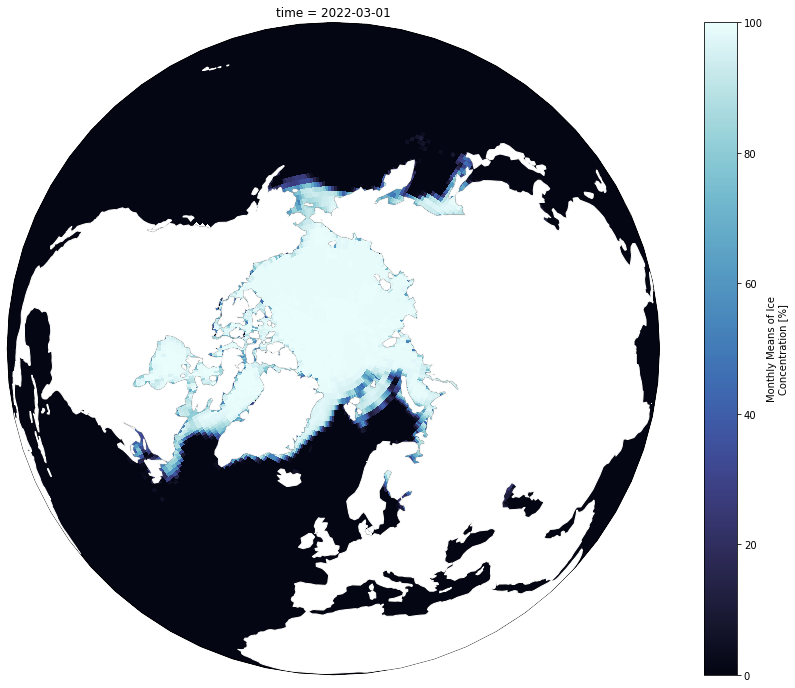

In [77]:
# North Pole - anno 2022

import cmocean

fig = plt.figure(figsize=(16,12))
ax = plt.axes(projection=ccrs.Orthographic(central_longitude=0.0, central_latitude=90))

p1a = icec_data.icec.isel(time=483).plot(transform=ccrs.PlateCarree(),
                                                       vmin=0,
                                                       vmax=100,   # messo +90 per polo nord?? prima era sud e ed era -90
                                                       cmap=cmocean.cm.ice)




ax.add_feature(cfeature.LAND,zorder=4,color='white')

p1a.axes.coastlines()

# risultati un po strani

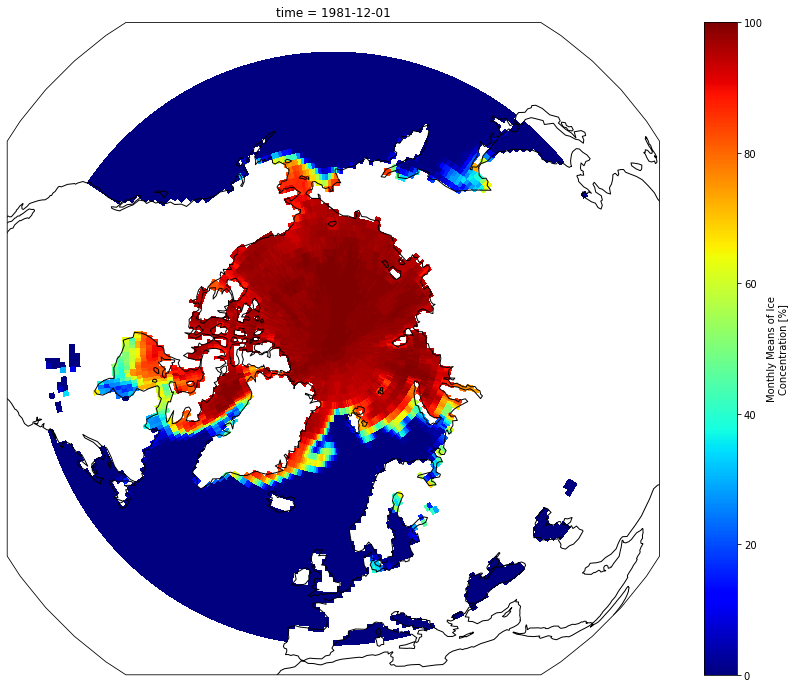

In [33]:
# North Pole - anno 1981, con zoom sul polo nord

# faccio slice sulle lat, prendo i primi 50 elementi di lat e tutte le longitidudini
fig = plt.figure(figsize=(16,12))
p1a = icec_data.icec.isel(time=0,lat=slice(0,50)).plot(transform=ccrs.PlateCarree(),
                                                       vmin=0,
                                                       vmax=100,
                                                       subplot_kws={'projection': ccrs.Orthographic(central_longitude=0.0, central_latitude=90)},
                                                       cmap='jet')
p1a.axes.coastlines()

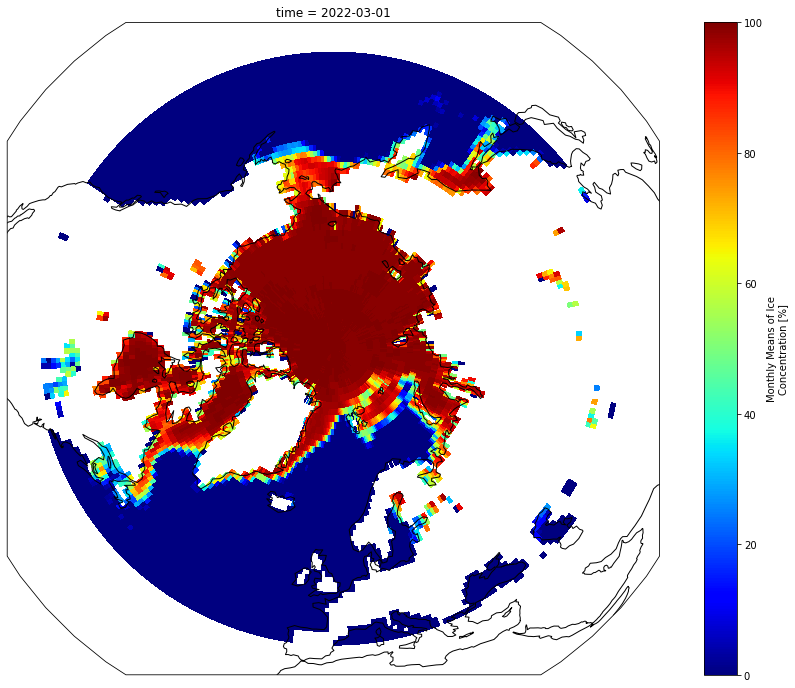

In [57]:
# North Pole - anno 2022, con zoom sul polo nord

# faccio slice sulle lat, prendo i primi 50 elementi di lat e tutte le longitidudini
fig = plt.figure(figsize=(16,12))

p1a = icec_data.icec.isel(time=483,lat=slice(0,50)).plot(transform=ccrs.PlateCarree(),
                                                       vmin=0,
                                                       vmax=100,
                                                       subplot_kws={'projection': ccrs.Orthographic(central_longitude=0.0, central_latitude=90)},
                                                       cmap='jet')



p1a.axes.coastlines()

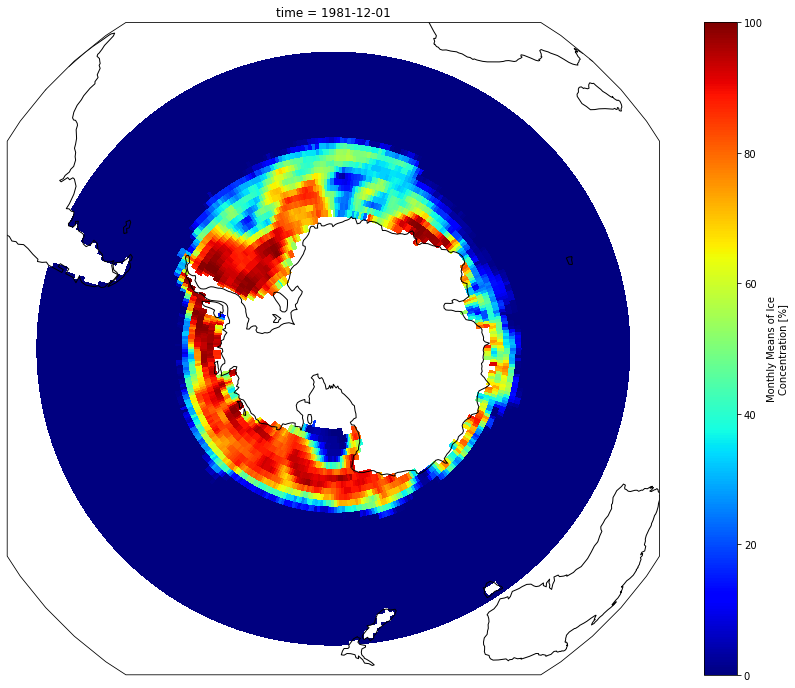

In [35]:
# South Pole - anno 1981

# faccio slice sulle lat, prendo i primi 50 elementi di lat e tutte le longitidudini
fig = plt.figure(figsize=(16,12))
p1a = icec_data.icec.isel(time=0,lat=slice(130,180)).plot(transform=ccrs.PlateCarree(),
                                                          vmin=0,
                                                          vmax=100,
                                                          subplot_kws={'projection': ccrs.Orthographic(central_longitude=0.0, central_latitude=-90)},   # messo +90 per polo nord?? prima era sud e ed era -90
                                                          cmap='jet')
p1a.axes.coastlines()

In [36]:
# serie temporale mensile globale

# è una grande media, quindi un'aggregazione spaziale a differenza di fare l'interpolazione

icec_data.mean(("lon", "lat"), keep_attrs=True).icec.hvplot()  # a livello mensile

:Curve   [time]   (icec)

In [37]:
icec_data.isel(lat=slice(0,50))

<xarray.Dataset>
Dimensions:    (time: 484, lat: 50, lon: 360, nbnds: 2)
Coordinates:
  * lat        (lat) float32 89.5 88.5 87.5 86.5 85.5 ... 43.5 42.5 41.5 40.5
  * lon        (lon) float32 0.5 1.5 2.5 3.5 4.5 ... 356.5 357.5 358.5 359.5
  * time       (time) datetime64[ns] 1981-12-01 1982-01-01 ... 2022-03-01
Dimensions without coordinates: nbnds
Data variables:
    icec       (time, lat, lon) float32 100.0 100.0 100.0 100.0 ... nan nan nan
    time_bnds  (time, nbnds) datetime64[ns] 1981-12-01 1982-01-01 ... 2022-04-01
Attributes:
    title:          NOAA Optimum Interpolation (OI) SST V2
    Conventions:    CF-1.0
    history:        Wed Apr  6 13:51:42 2005: ncks -d time,0,278 SAVEs/icec.m...
    comments:       Data described in  Reynolds, R.W., N.A. Rayner, T.M.\nSmi...
    platform:       Model
    source:         NCEP Climate Modeling Branch
    institution:    National Centers for Environmental Prediction
    References:     https://www.psl.noaa.gov/data/gridded/data.noaa.oisst.v2....
    NCO:            4.0.0
    dataset_title:  NOAA Optimum Interpolation (OI) SST V2
    source_url:     http://www.emc.ncep.noaa.gov/research/cmb/sst_analysis/

In [38]:
# serie temporale mensile della zona del polo nord

icec_data.isel(lat=slice(0,50)).mean(("lon", "lat"), keep_attrs=True).icec.hvplot()  # a differenza dello stesso grafico nella sezione sopra qui abbiamo selezionato l'area del polo nord

# la concentrazione diminuisce tanto nel mese di settembre

# sicuramente di vede un trend negativo che significa che la percentuald ei ghiacciai è diminuita nel tempo

:Curve   [time]   (icec)

In [39]:
# sarebbe bello e interessante vedere se ad un aumento della temperatura c'è stato anche una dimnunzione delle percentuali di ghiaccio, nei poli

# serie storica temperature ai poli
icec_data.lat[0]  # 86, simao abbastanza in alto, verso il polo nord
icec_data.lon[80]  # 160
# queste coordinate si vedono in alto al grafico

icec_data.icec.groupby("time.month").mean("time")[:,0,80].hvplot()

# qui dsi vede nel dettaglio quello notato sopra, al polo nord nel mese di agosto settembre vi è la minore concentrazioend i ghiaccio nelle acque

:Curve   [month]   (icec)

In [40]:
# vediamo se a questa diminuzione di ghiaccio corrisponde un netto aumento della temperatura (questa parte si potrebbe fare con più attenzione nella terza parte di cofnronto in cui oepriamo anche un regridding altrimenti rischiamo di confrontare celle diverse)

In [41]:
sst_data.lat[0]
sst_data.lon[80]

sst_data.sst.groupby("time.month").mean("time")[:,0,80].hvplot()

# effettivamente proprio ad agosto / settmebre si nota un aumento (QUASI PARI A ZERO) seppur minimo delle temperatuire

:Curve   [month]   (sst)

# Test regridding

In [42]:
# sarò necessario se devo fare confronti diretti tra i due dataset

# interpolo d2 su d1 essendo la griglia di d2 più grande

# i valori ovviamente cambiano

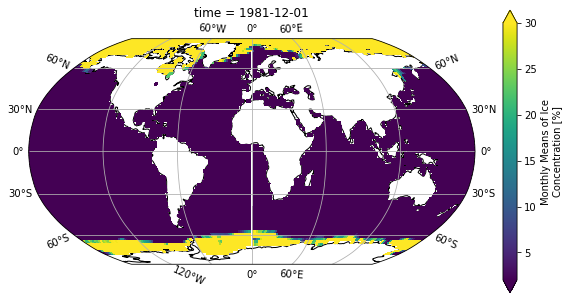

In [43]:
d1 = sst_data
d2 = icec_data

d2i_lin = d2.interp(lat=d1.lat, lon=d1.lon, method='linear')  # è il tipo (linear) più utilizzato, la griglia è quella dell'altro modello, il secondo modello è stato riportato sulla griglia del primo
d2i_lin.icec



# per un mese specifico
sst = d2i_lin.icec.sel(time='1981-12-01', method='nearest')
fig = plt.figure(figsize=(10,13))
ax = plt.axes(projection=ccrs.Robinson())
ax.coastlines()
ax.gridlines(draw_labels=True)
sst.plot(ax=ax, transform=ccrs.PlateCarree(),
         vmin=2, vmax=30, cbar_kwargs={'shrink': 0.4})

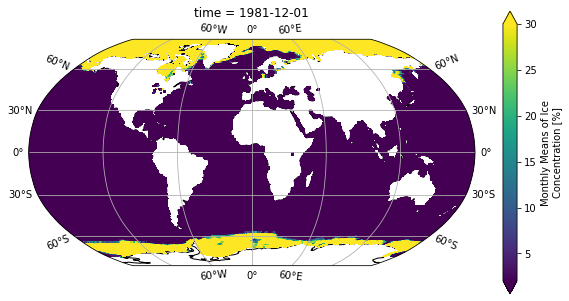

In [39]:
icec_data.icec



# per un mese specifico
sst = icec_data.icec.sel(time='1981-12-01', method='nearest')
fig = plt.figure(figsize=(10,13))
ax = plt.axes(projection=ccrs.Robinson())
ax.coastlines()
ax.gridlines(draw_labels=True)
sst.plot(ax=ax, transform=ccrs.PlateCarree(),
         vmin=2, vmax=30, cbar_kwargs={'shrink': 0.4})

In [40]:
# non si riescono ad apprezzare grandi differenze tra versione originale e regriddata

# Confronti

In [41]:
# QUESTIONE GRIGLIE

# risolvere questioni grdi, eventualmente convertire long da 0 360 a -180 a 180, capire se sono centroidi o meno
# We can traspose it to [-180,180] - in tanti anche online fanno questa conversione quindi ci sta farla
# ts1.coords['lon'] = (ts1.coords['lon'] + 180) % 360 - 180
# ts1 = ts1.sortby(ts1.lon)

# magari le mie lat sono dei centrodi , ho bande di 5 da 90 a 87,
# 88   86   84   ad esempio 86 è il centroide della banda 87 --- 85  poi 84 è il cenbtrodide della banda 85 --- 83  -> magari scrvio al prof
# nel caso comprendere se ad esempio 88 è la linea o la banda?!

# per comprendere bande lat e long:
# https://www.settorezero.com/wordpress/basi-della-cartografia-convertiamo-latitudine-e-longitudine-da-base60-a-decimale-il-sistema-sessagesimale-e-i-suoi-utilizzi-pratici/

# The number of elements is the same along the lat dimension (145), meaning that each grid cell is
#  identified (for the y-dimension) by the "centroid" rather than the "edges" of the grid cell.
# The "edges" of the grid cells are stored in lat_bnds.
# Note that the first and last elements of lat (the two poles) are an exception, because these particular
#  grid cells are identified not by the centroids, but by the outer edges!

In [43]:
# QUESTIONE REGRIDDING VS MEDIA PESATA

# rivedere concetto media pesata per interopolazione: grid-cell areas weighting, utilizzare un peso proporzionale alle aree delle celle
# per fare l'aggregazione spaziale è importante considerare che su uan griglia lat e long le aeree delle celle sono diverse, tendono a diminuire verso i poli. Risulta dunque necessario effettuare una media pesata con i pesi che siano proporzionali alle aree delle celle. Si può usare ad esempio la funzione coseno per creare questi pesi
# funzione cos
# ottengo una serie di pesi che sono deifniti per ciascuna banda di latitudine
# il primo peso infatti è molto piccolo, siamo vicini ad un polo, e poi verso l'equatore diventano più grandi

# (5) Second step of spatial aggregation: derive the global time series from the gridded dataset
# devo fare un'aggregazione di tutte le celle
# Here we have the options of a simple arithmetic average, or a weighted average
# The weights could be on several levels, e.g.
# - a measure of the density of observations or their coherence
# - the unequal areas covered by each grid cell
# - the unequal proportions of land vs ocean in different grid cells
# - ...
# in ogni caso la media aritmetica è incorretta, meglio usare quella pesata (modulo 2)

# capire se ha senso interpolazione normale e se è necessaria


# regridding diverso da aggregazione spaziale


# il regridding probabilmente mi servirà se devo fare dei confornti in cui ho dati che non sono ancora a livello globale, ma nel caso in cui opero a livello globale, quindi faccio uan media su lat e long a quel punto non mi interessa più avere la stessa griglia con lo stesso numero di lat e long tanto orami sto suando una sintesi globale.

In [ ]:
# the  latitude/longitude  values  in the netCDF coordinate
#     variables are the centers of the grid cells.
#
#
# tante info:  https://rda.ucar.edu/datasets/ds277.0/docs/NetCDF_README
# ma anche sul sito principale stesso dice delle lat e delle long

In [ ]:
# essendo dei dati interpolati è necessario mascherare i continenti, stiamo parlando delle temperature, usiamo la funzione apposta che possiamo usare anche nelle mappe dei grafici per avere i cotnienti piùd eifniti

# però missa che con i ghiacciai rischiamo di perdere informazioni improtnati, tipo i ghiaccia sulle montagne anche se per noi non sono fondamentali. piuttosto allora lo faccio solo per le acque
#
#
# Note, the ice land mask is a function of the ice analysis and may change periodically.
#
# non vorrei che sia importnate usare la mask fornita
#
#
#
#
#
#
#
# risoltoooooooooooooooooooooooooo
#
#
# dmask  = xr.open_dataset('C:/Users/loren/Desktop/lsmask.nc')
# dmask
#
#
# ds = sst_data_MONTH
# ds['sst'] = ds.sst.where(dmask.mask.isel(time=0) == 1)
#
#
#
# cosi con le temp uso questa mask mentre con i ghiacciai è già apposto
#
#
#
# capire la questione dei dati se sono stati interpolati o mneo
# https://notebooks.githubusercontent.com/view/ipynb?browser=chrome&color_mode=auto&commit=87b1965eea8837e2e7b6c3402d02228515c1ec69&device=unknown&enc_url=68747470733a2f2f7261772e67697468756275736572636f6e74656e742e636f6d2f726f79616c6f7379696e2f507974686f6e2d50726163746963616c2d4170706c69636174696f6e2d6f6e2d436c696d6174652d566172696162696c6974792d537475646965732f383762313936356565613838333765326537623663333430326430323232383531356331656336392f657831352d5472656e64253230616e64253230416e6f6d616c79253230416e616c797365732532306f662532304c6f6e672d7465726d25323054656d70726f2d5370617469616c253230446174617365742e6970796e62&logged_in=false&nwo=royalosyin%2FPython-Practical-Application-on-Climate-Variability-Studies&path=ex15-Trend+and+Anomaly+Analyses+of+Long-term+Tempro-Spatial+Dataset.ipynb&platform=android&repository_id=104421496&repository_type=Repository&version=96
#
#
# Commonly known as OI, this procedure provides an estimate of the state of the atmosphere by a weighted least squares fit to observations and a background field, usually provided by a NWP model forecast.
#
#
# noaa: National oceanic and atmosferic administration
# OI : optimun interpolatoion
# sst: sea surface temp
#
#
# https://journals.ametsoc.org/view/journals/clim/15/13/1520-0442_2002_015_1609_aiisas_2.0.co_2.xml
# paper ufficiale
#
#
# da quanto ho capito abbiamo tante osservazioni, per la temp ad esemio, tipo navi e boe, si fa un inteprolazionequindi asseganndo pesi diversi alle singoel cose


# https://ui.adsabs.harvard.edu/abs/1994JCli....7..929R/abstract


# A high-resolution sea surface temperature analysis product that blends in situ (ship and buoy) reports and satellite data and uses optimum interpolation to fill spatial gaps.